# Survey Plan Training Tool v2.1

**Author:** Evan Juras, [EJ Technology Consultants](https://ejtech.io), Jadon Williams

**Last updated:** February 2, 2026

**Original repository:** [Train and Deploy YOLO Models](https://github.com/EdjeElectronics/Train-and-Deploy-YOLO-Models)

# Introduction

This notebook uses [Ultralytics](https://docs.ultralytics.com/) to train SAHI enabled YOLO26, YOLO11, YOLOv8, or YOLOv5 object detection models with a custom dataset.

This notebook was entirely created and maintained by Evan Juras at [EJ Technology Consultants](https://ejtech.io) until January 10, 2026. I have copied it, stripped it down, and made slight modifications to enable SAHI functionality to accomodate our high resolution data. All of which is permitted under the Apache 2.0 license.

The original notebook can be found [here](https://www.youtube.com/redirect?event=video_description&redir_token=QUFFLUhqbUNuOW9VVzl3bWNSd3c2S296UGZVMWVSNjBKUXxBQ3Jtc0trUUU1cHN1S1V6QV8zbkFsdGg1WWpxYTRyZllhWFBmYkliZFAzWUMwUEJYazdmR1N1UE5sc1pjdHRWemNnM3YwOFo1YTBuMC10aUhWanhxUnFjWVpEeWF0WTVtVWlWNUpvRElTOFFib0pONFc5TjFxTQ&q=https%3A%2F%2Fcolab.research.google.com%2Fgithub%2FEdjeElectronics%2FTrain-and-Deploy-YOLO-Models%2Fblob%2Fmain%2FTrain_YOLO_Models.ipynb&v=r0RspiLG260).


### Working in Colab
Colab provides a virtual machine in the browser with a Linux OS, filesystem, Python environment, and a free GPU. We'll install PyTorch and Ultralytics in this environment and use it to train our model. Simply click the Play button on sections of code in this notebook to execute them on the virtual machine.


**Verify NVIDIA GPU Availability**

Make sure you're using a GPU-equipped machine by going to "Runtime" -> "Change runtime type" in the top menu bar, and then selecting one of the GPU options in the Hardware accelerator section. Click Play on the following code block to verify that the NVIDIA GPU is present and ready for training.

In [ ]:
!nvidia-smi

Mon Feb  2 19:33:50 2026       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   44C    P8              9W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

# 1.&nbsp;Upload Image Dataset and Prepare Training Data

First upload the dataset and prepare it for training with YOLO. We'll split the dataset into train and validation folders, and we'll automatically generate the configuration file for training the model.

## 1.1 Upload images

Upload the `data.zip` file to the Google Colab instance by clicking the "Files" icon on the left hand side of the browser, and then the "Upload to session storage" icon.

<p>
<br>
<img src="https://raw.githubusercontent.com/EdjeElectronics/Train-and-Deploy-YOLO-Models/refs/heads/main/doc/upload-colab-files.png" height="240">
</p>


## 1.2 Split images into train and validation folders





 Next, we'll unzip `data.zip` and create some folders to hold the images. Run the following code block to unzip the data.

In [ ]:
# Unzip images to a custom data folder
!unzip -q /content/data.zip -d /content/custom_data

Ultralytics requires a particular folder structure to store training data for models. The root folder is named “data”. Inside, there are two main folders:

*   **Train**: These are the actual images used to train the model. In one epoch of training, every image in the train set is passed into the neural network. The training algorithm adjusts the network weights to fit the data in the images.


*   **Validation**: These images are used to check the model's performance at the end of each training epoch.

In each of these folders is a “images” folder and a “labels” folder, which hold the image files and annotation files respectively.


The following Python script will automatically create the required folder structure and randomly move 90% of dataset to the "train" folder and 10% to the "validation" folder. Run the following code block to download and execute the scrpt.

In [ ]:
!wget -O /content/train_val_split.py https://raw.githubusercontent.com/EdjeElectronics/Train-and-Deploy-YOLO-Models/refs/heads/main/utils/train_val_split.py

# TO DO: Improve robustness of train_val_split.py script so it can handle nested data folders, etc
!python train_val_split.py --datapath="/content/custom_data" --train_pct=0.9

--2026-02-02 19:44:13--  https://raw.githubusercontent.com/EdjeElectronics/Train-and-Deploy-YOLO-Models/refs/heads/main/utils/train_val_split.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3203 (3.1K) [text/plain]
Saving to: ‘/content/train_val_split.py’

/content/train_val_ 100%[===================>]   3.13K  --.-KB/s    in 0s      

2026-02-02 19:44:13 (47.9 MB/s) - ‘/content/train_val_split.py’ saved [3203/3203]

Created folder at /content/data/train/images.
Created folder at /content/data/train/labels.
Created folder at /content/data/validation/images.
Created folder at /content/data/validation/labels.
Number of image files: 58
Number of annotation files: 0
Images moving to train: 52
Images moving to validation: 6


# 2.&nbsp;Install Requirements (Ultralytics)

Next, we'll install the Ultralytics library in this Google Colab instance. This Python library will be used to train the YOLO model.

In [ ]:
# Install Ultralytics and SAHI for sliced inference
!pip install ultralytics sahi

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 32.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 111.7/111.7 kB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.0/63.0 MB 11.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.9/115.9 kB 14.1 MB/s eta 0:00:00
  Attempting uninstall: opencv-python
    Found existing installation: opencv-python 4.13.0.90
    Uninstalling opencv-python-4.13.0.90:
      Successfully uninstalled opencv-python-4.13.0.90


# 3.&nbsp;Configure Training


Next, we need to create the Ultralytics training configuration YAML file. This file specifies the location of your train and validation data, and it also defines the model's classes. An example configuration file model is available [here](https://github.com/ultralytics/ultralytics/blob/main/ultralytics/cfg/datasets/coco128.yaml).

Run the code block below to automatically generate a `data.yaml` configuration file. Make sure you have a labelmap file located at `custom_data/classes.txt`. If you used Label Studio or one of my pre-made datasets, it should already be present. If you assembled the dataset another way, you may have to manually create the `classes.txt` file (see [here](https://github.com/EdjeElectronics/Train-and-Deploy-YOLO-Models/blob/main/doc/classes.txt) for an example of how it's formatted).

In [ ]:
# ==============================================================================
# 3. SLICE & CONVERT TO OBB
# ==============================================================================
def convert_to_obb(json_file, out_img_dir, out_lbl_dir):
    Path(out_img_dir).mkdir(parents=True, exist_ok=True)
    Path(out_lbl_dir).mkdir(parents=True, exist_ok=True)

    with open(json_file) as f:
        data = json.load(f)

    cats = {c['id']: c['name'] for c in data['categories']}

    for img in data['images']:
        # 1. Copy Image
        # Sliced images are created relative to the json by SAHI
        src_img = Path(json_file).parent / img['file_name']
        if src_img.exists():
            shutil.copy(src_img, Path(out_img_dir) / img['file_name'])

        # 2. Convert Poly -> OBB
        anns = [a for a in data['annotations'] if a['image_id'] == img['id']]
        lines = []
        for ann in anns:
            if 'segmentation' in ann and ann['segmentation']:
                poly = np.array(ann['segmentation'][0]).reshape(-1, 2).astype(np.float32)
                rect = cv2.minAreaRect(poly)
                box = cv2.boxPoints(rect)

                # Normalize
                norm_box = []
                for pt in box:
                    norm_box.extend([
                        max(0, min(1, pt[0] / img['width'])),
                        max(0, min(1, pt[1] / img['height']))
                    ])
                lines.append(f"{ann['category_id']} {' '.join(f'{x:.6f}' for x in norm_box)}")

        with open(Path(out_lbl_dir) / (Path(img['file_name']).stem + ".txt"), 'w') as f:
            f.write("\n".join(lines))

    return cats

detected_classes = {}

for split_name, json_path in splits.items():
    print(f"Processing {split_name}...")

    # A. Slice
    sliced_out = os.path.join(SLICED_BASE, split_name)
    print(f"  - Slicing to {sliced_out}...")

    # --- FIX IS HERE: Unpack the tuple directly ---
    sliced_coco_dict, sliced_coco_path = slice_coco(
        coco_annotation_file_path=json_path,
        image_dir=found_img_dir,
        output_coco_annotation_file_name=f"sliced_{split_name}",
        output_dir=sliced_out,
        slice_height=640,
        slice_width=640,
        overlap_height_ratio=0.2,
        overlap_width_ratio=0.2,
        verbose=False
    )

    # B. Convert
    print(f"  - Converting to YOLO OBB...")
    classes = convert_to_obb(
        sliced_coco_path, # Use the path string we just unpacked
        os.path.join(OBB_DIR, split_name, "images"),
        os.path.join(OBB_DIR, split_name, "labels")
    )
    detected_classes.update(classes)

print(f"\nClasses detected: {detected_classes}")

Processing train...
  - Slicing to /content/sliced_dataset/train...


100%|██████████| 46/46 [02:41<00:00,  3.50s/it]


  - Converting to YOLO OBB...
Processing val...
  - Slicing to /content/sliced_dataset/val...


100%|██████████| 12/12 [00:40<00:00,  3.38s/it]


  - Converting to YOLO OBB...

Classes detected: {0: 'adj lot', 1: 'anbls valnum', 2: 'area', 3: 'azimuth', 4: 'calc', 5: 'coord table', 6: 'counsel stamp', 7: 'curve data', 8: 'curve table', 9: 'dev stamp', 10: 'distance', 11: 'ip', 12: 'key plan', 13: 'legend', 14: 'line table', 15: 'lot number', 16: 'nbls signature', 17: 'north arrow', 18: 'notes', 19: 'owner signature', 20: 'pin num', 21: 'plan date', 22: 'plan purpsoe', 23: 'plan title', 24: 'ribf', 25: 'scale bar', 26: 'smf', 27: 'sms', 28: 'sqib', 29: 'title data'}


# 4.&nbsp;Train Model

## 4.1 Training Parameters
Now that the data is organized and the config file is created, we're ready to start training. First, there are a few important parameters to decide on. Visit Evan Juras' article on [Training YOLO Models Locally](https://www.ejtech.io/learn/train-yolo-models) to learn more about these parameters and how to choose them.

**Model architecture & size (`model`):**

There are several YOLO11 models sizes available to train, including `yolo11n.pt`, `yolo11s.pt`, `yolo11m.pt`, `yolo11l.pt`, and `yolo11xl.pt`. Larger models run slower but have higher accuracy, while smaller models run faster but have lower accuracy. Evan Juras made a brief YouTube video that compares performance of different YOLO models on a Raspberry Pi 5 and a laptop with a RTX 4050 GPU, [check it out here to get a sense of their speed accuracy](https://youtu.be/_WKS4E9SmkA). If you aren't sure which model size to use, `yolo11s.pt` is a good starting point.

You can also train YOLOv8 or YOLOv5 models by substituting `yolo11` for `yolov8` or `yolov5`.


**Number of epochs (`epochs`)**

In machine learning, one “epoch” is one single pass through the full training dataset. Setting the number of epochs dictates how long the model will train for. The best amount of epochs to use depends on the size of the dataset and the model architecture. If your dataset has less than 200 images, a good starting point is 60 epochs. If your dataset has more than 200 images, a good starting point is 40 epochs.


**Resolution (`imgsz`)**

Resolution has a large impact on the speed and accuracy of the model: a lower resolution model will have higher speed but less accuracy. YOLO models are typically trained and inferenced at a 640x640 resolution. However, if you want your model to run faster or know you will be working with low-resolution images, try using a lower resolution like 480x480.


## 4.2 Run Training!

Run the following code block to begin training. If you want to use a different model, number of epochs, or resolution, change `model`, `epochs`, or `imgsz`.

In [ ]:
import os
import yaml
from ultralytics import YOLO

# ==============================================================================
# 1. AUTO-DETECT PATHS
# ==============================================================================
# Define root dataset directory (must match the one from the previous step)
obb_dir = '/content/survey_obb_dataset'

# Check which validation folder exists ('val' or 'valid')
if os.path.exists(os.path.join(obb_dir, 'val')):
    val_folder = 'val'
elif os.path.exists(os.path.join(obb_dir, 'valid')):
    val_folder = 'valid'
else:
    # Fallback: list folders to find it
    subdirs = [d for d in os.listdir(obb_dir) if os.path.isdir(os.path.join(obb_dir, d))]
    val_folder = next((d for d in subdirs if d not in ['train']), None)

if not val_folder:
    raise FileNotFoundError(f"Could not find validation folder in {obb_dir}")

print(f"✅ Detected validation folder: {val_folder}")

# ==============================================================================
# 2. GENERATE CONFIG (Using detected paths)
# ==============================================================================
# Load class names if variable exists, otherwise try to load from previous step
if 'detected_classes' not in locals():
    # Attempt to load from the auto-split we did earlier if detected_classes is lost
    # (This is a failsafe if you restarted the runtime)
    try:
        import json
        train_json = '/content/temp_splits/train.json' # Path from previous step
        with open(train_json) as f:
            data = json.load(f)
            detected_classes = {c['id']: c['name'] for c in data['categories']}
    except:
        print("⚠️ Warning: Could not auto-load classes. Ensure 'detected_classes' is defined.")
        detected_classes = {0: 'object'} # Fallback

config = {
    'path': obb_dir,
    'train': 'train/images',
    'val': f'{val_folder}/images', # Uses the detected name
    'names': detected_classes
}

yaml_path = 'survey_plan_obb.yaml'
with open(yaml_path, 'w') as f:
    yaml.dump(config, f)

print(f"✅ Config saved to: {yaml_path}")

# ==============================================================================
# 3. TRAIN
# ==============================================================================
model_name = 'yolo26n-obb.pt' # or yolo26m-obb.pt

print(f"🚀 Starting training with {model_name}...")
model = YOLO(model_name)

results = model.train(
    data=yaml_path,
    epochs=5,       # Set to 100 for real training
    imgsz=640,
    batch=16,
    name='survey_plan_obb_run',
    device=0
)

✅ Detected validation folder: val
✅ Config saved to: survey_plan_obb.yaml
🚀 Starting training with yolo26n-obb.pt...
Ultralytics 8.4.10 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, angle=1.0, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=survey_plan_obb.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, end2end=None, epochs=5, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo26n-obb.pt, momentum=0.937, mosaic=1.0, multi_scale=0.0, name=survey_

The training algorithm will parse the images in the training and validation directories and then start training the model. At the end of each training epoch, the program runs the model on the validation dataset and reports the resulting mAP, precision, and recall. As training continues, the mAP should generally increase with each epoch. Training will end once it goes through the number of epochs specified by `epochs`.

> **NOTE:** Make sure to allow training to run to completion, because an optimizer runs at the end of training that strips out unneeded layers from the model.

The best trained model weights will be saved in `content/runs/detect/train/weights/best.pt`. Additional information about training is saved in the `content/runs/detect/train` folder, including a `results.png` file that shows how loss, precision, recall, and mAP progressed over each epoch.

#5.&nbsp;Test Model

The model has been trained; now it's time to test it! The commands below run the model on the images in the validation folder and then display the results for the first 10 images. This is a good way to confirm your model is working as expected. Click Play on the blocks below to see how your model performs.

In [ ]:
from ultralytics import YOLO
import os
import glob

# ==============================================================================
# 1. AUTO-DETECT DATASET PATH
# ==============================================================================
dataset_root = 'survey_obb_dataset'

# Check standard folder names
possible_paths = [
    os.path.join(dataset_root, 'val', 'images'),   # Most likely (created by our script)
    os.path.join(dataset_root, 'valid', 'images'), # Alternative standard
    os.path.join(dataset_root, 'test', 'images')   # Fallback
]

source_path = None
for path in possible_paths:
    if os.path.exists(path):
        source_path = path
        break

if not source_path:
    # Debugging info if it fails
    print(f"❌ Error: Could not find validation images inside '{dataset_root}'")
    if os.path.exists(dataset_root):
        print(f"Folders found: {os.listdir(dataset_root)}")
    else:
        print(f"Root folder '{dataset_root}' is missing entirely.")
    raise FileNotFoundError("Validation image folder not found.")

print(f"✅ Found validation images at: {source_path}")

# ==============================================================================
# 2. AUTO-DETECT MODEL (Finds latest run)
# ==============================================================================
# Try to find the specific run first
project_name = 'survey_plan_obb_run'
expected_path = f"runs/obb/{project_name}/weights/best.pt"

if os.path.exists(expected_path):
    model_path = expected_path
    print(f"✅ Found exact model: {model_path}")
else:
    # If explicit path fails, find the most recent 'best.pt' in any OBB run
    found_files = glob.glob("runs/obb/**/best.pt", recursive=True)
    if found_files:
        model_path = sorted(found_files, key=os.path.getmtime)[-1]
        print(f"⚠️ Exact path not found. Using latest detected model: {model_path}")
    else:
        raise FileNotFoundError("CRITICAL: No 'best.pt' found in runs/obb/. Training may have failed.")

# ==============================================================================
# 3. RUN PREDICTION
# ==============================================================================
print(f"🚀 Starting inference...")
model = YOLO(model_path)

results = model.predict(
    source=source_path, # Uses the auto-detected path
    conf=0.25,          # Confidence threshold
    save=True,          # Save images with boxes
    project='runs/obb/predict',
    name='test_results'
)

print(f"\n✅ Predictions saved to: runs/obb/predict/test_results")
# Note: In Colab, check the file browser on the left to see the images!

✅ Found validation images at: survey_obb_dataset/val/images
⚠️ Exact path not found. Using latest detected model: runs/obb/survey_plan_obb_run3/weights/best.pt
🚀 Starting inference...

WARNING ⚠️ 
Inference results will accumulate in RAM unless `stream=True` is passed, which can cause out-of-memory errors for large
sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

image 1/1400 /content/survey_obb_dataset/val/images/0817141d-46704798_page-0001_5_0_0_640_640.png: 640x640 (no detections), 12.1ms
image 2/1400 /content/survey_obb_dataset/val/images/0817141d-46704798_page-0001_5_0_1024_640_1664.png: 640x640 1 adj lot, 12.9ms
image 3/1400 /

Processing 8486a02c-31134753_simpler_page-0001.jpg with SAHI...
Performing prediction on 63 slices.
Processing 668dcfe1-43551952_simpler_page-0001.jpg with SAHI...
Performing prediction on 54 slices.
Processing a29d57d4-44927631_simpler_page-0001.jpg with SAHI...
Performing prediction on 24 slices.
Processing e86f3dbf-33248148_simpler_page-0001.jpg with SAHI...
Performing prediction on 30 slices.
Processing 45935639-38134384.pdf_2.jpg with SAHI...
Performing prediction on 42 slices.


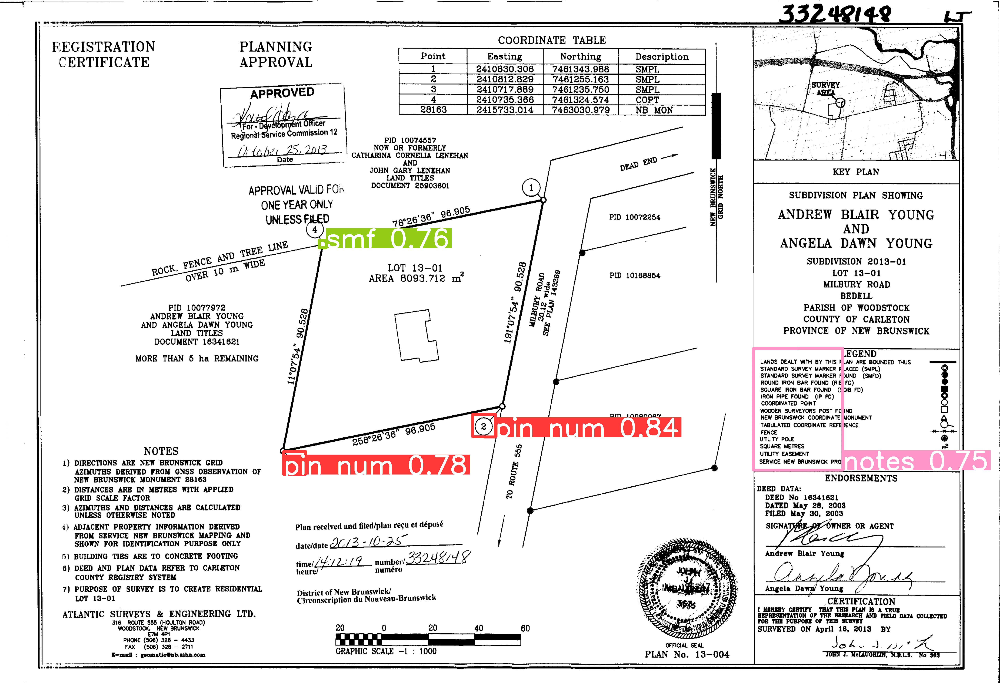

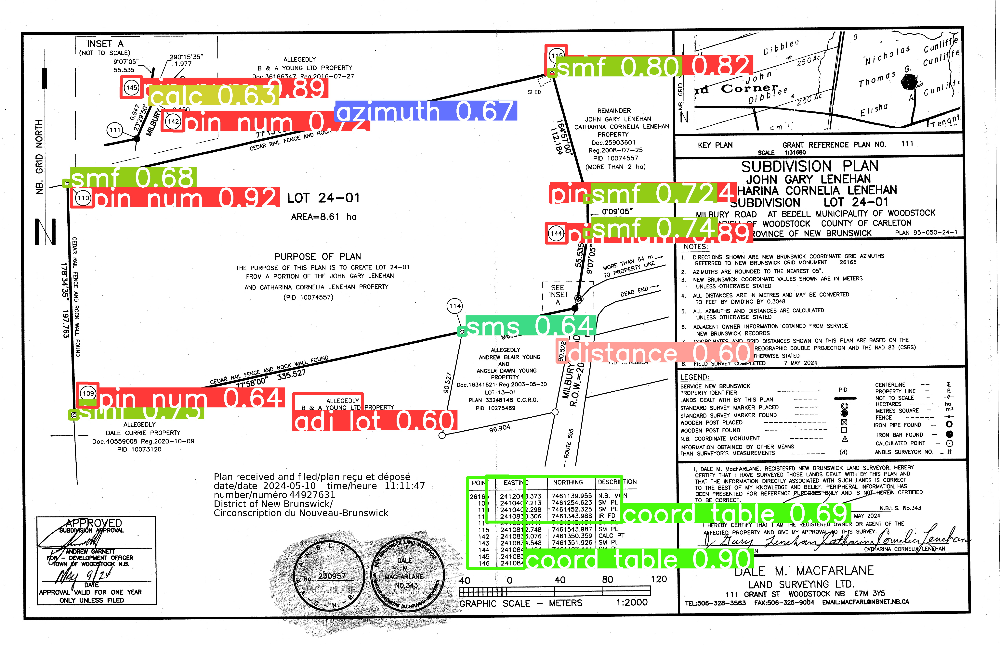

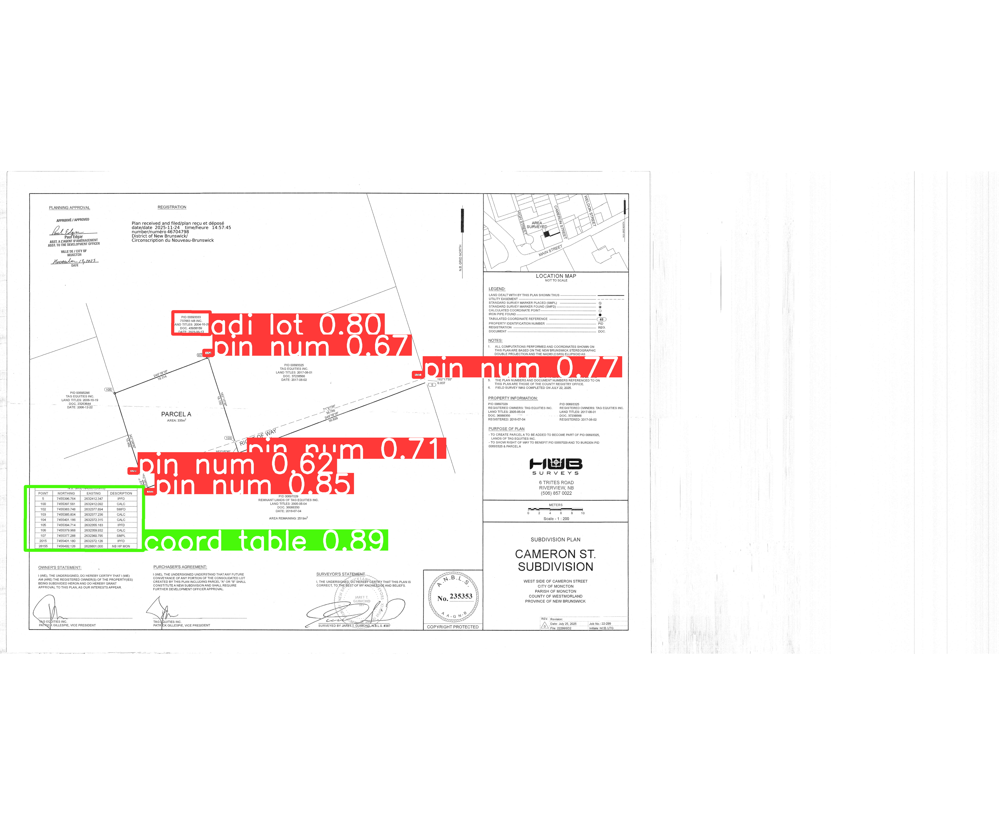

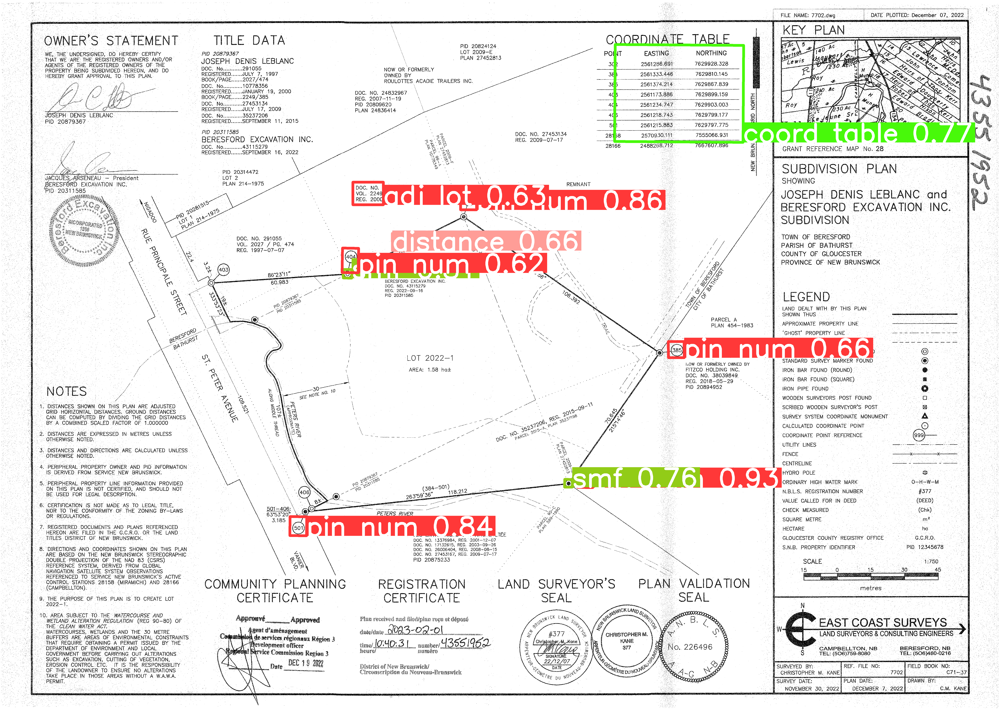

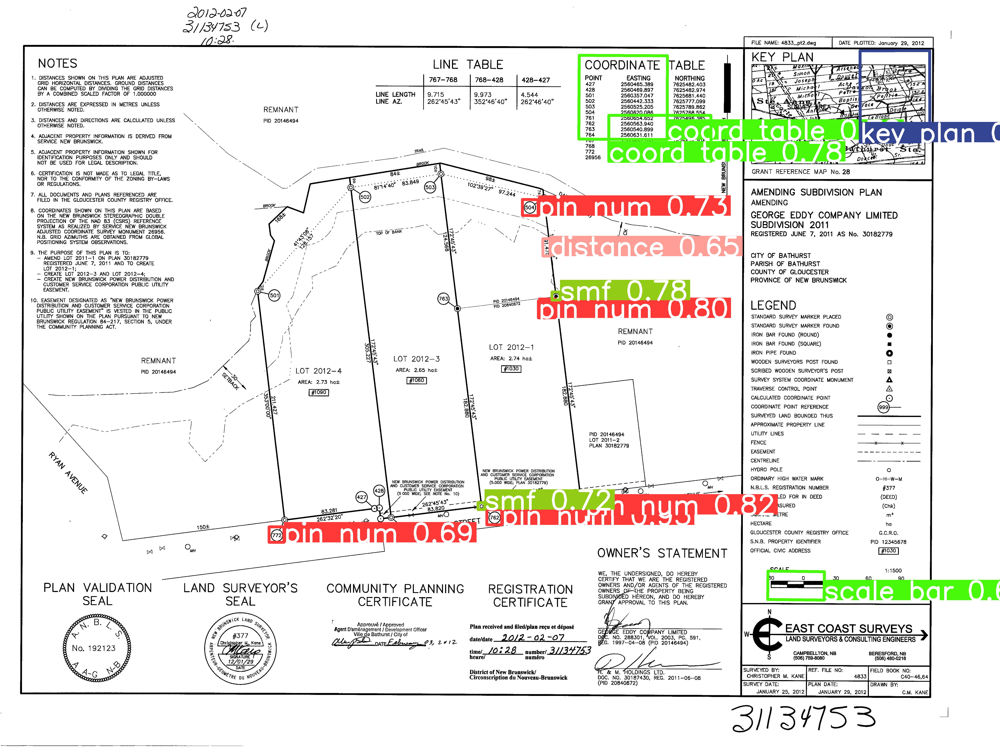

In [ ]:
# --- SAHI SLICED INFERENCE FOR SURVEY PLANS ---
from sahi import AutoDetectionModel
from sahi.predict import get_sliced_prediction
from IPython.display import Image, display
import glob
import os

# 1. Load your trained model into the SAHI wrapper
# This points to the 'best.pt' generated in Section 4
# The variable 'model_path' from the previous cell (PooP5Vjsg2Jn) holds the correct path
detection_model = AutoDetectionModel.from_pretrained(
    model_type='ultralytics',
    model_path=model_path, # Using the dynamically detected model_path
    confidence_threshold=0.60, # Adjust this to filter out weak detections
    device='cuda:0' # Uses the Colab GPU
)

# 2. Create a folder for SAHI results
os.makedirs('/content/runs/sahi_predict', exist_ok=True)

# 3. Run Sliced Prediction on the first 5 images from validation
# We use 1024px slices because survey plans are high-res
test_images = glob.glob('/content/data/validation/images/*.jpg')[:5]

for image_path in test_images:
    image_name = os.path.basename(image_path)
    print(f"Processing {image_name} with SAHI...")

    result = get_sliced_prediction(
        image_path,
        detection_model,
        slice_height=1024,
        slice_width=1024,
        overlap_height_ratio=0.2,
        overlap_width_ratio=0.2,
        postprocess_type="NMS", # Merges boxes that overlap between slices
        postprocess_match_threshold=0.5
    )

    # Save the visualized result
    result.export_visuals(
        export_dir='/content/runs/sahi_predict/',
        file_name=image_name.replace('.jpg', '')
    )

# 4. Display the results
for result_img in glob.glob('/content/runs/sahi_predict/*.png'):
    display(Image(filename=result_img, width=800))
    print('\n')


The model should draw a box around each object of interest in each image. If it isn't doing a good job of detecting objects, here are a few tips:

1. Double-check your dataset to make sure there are no labeling errors or conflicting examples.
2. Increase the number of epochs used for training.
3. Use a larger model size (e.g. `yolo11l.pt`).
4. Add more images to the training dataset. See my [dataset video](https://www.youtube.com/watch?v=v0ssiOY6cfg) for tips on how to capture good training images and improve accuracy.

You can also run the model on video files or other images images by uploading them to this notebook and using the above `!yolo detect predict` command, where `source` points to the location of the video file, image, or folder of images. The results will be saved in `runs/detect/predict`.

Drawing boxes on images is great, but it isn't very useful in itself. It's also not very helpful to just run this models inside a Colab notebook: it's easier if we can just run it on a local computer. Continue to the next section to see how to download your newly trained model and run it on a local device.

#6.&nbsp;Deploy Model

Now that your custom model has been trained, it's ready to be downloaded and deployed in an application! YOLO models can run on a wide variety of hardware, including PCs, embedded systems, and phones. Ultralytics makes it easy to convert the YOLO models to various formats (`tflite`, `onnx`, etc.) and deploy them in a variety of environments.

This section shows how to download the model and provides links to instructions for deploying it on your PC and edge devices like the Raspberry Pi.

## 6.1 Download YOLO Model

First, zip and download the trained model by running the code blocks below.

The code creates a folder named `my_model`, moves the model weights into it, and renames them from `best.pt` to `my_model.pt`. It also adds the training results in case you want to reference them later. It then zips the folder as `my_model.zip`.

In [ ]:
import os
import shutil
import glob
from google.colab import files

# ==============================================================================
# 5. EXPORT & DOWNLOAD (FIXED FOR OBB)
# ==============================================================================
print("Preparing download...")

# 1. Search in the correct 'obb' directory
search_root = "/content/runs/obb"

if not os.path.exists(search_root):
    print(f"❌ Error: The folder '{search_root}' does not exist. Did training finish successfully?")
else:
    # Get all project folders (e.g., survey_plan_obb_run, survey_plan_obb_run2)
    # We ignore files, only look for directories
    run_folders = [f for f in glob.glob(os.path.join(search_root, '*')) if os.path.isdir(f)]

    if not run_folders:
        print(f"❌ Error: No run folders found inside {search_root}")
    else:
        # 2. Find the latest run automatically
        latest_run = max(run_folders, key=os.path.getmtime)
        print(f"✅ Found latest training run: {latest_run}")

        # 3. Create Zip File
        output_zip = "/content/survey_plan_obb_results.zip"
        print(f"Compressing results to {output_zip}...")

        # shutil.make_archive expects the base name (without .zip) and the dir to zip
        shutil.make_archive(output_zip.replace('.zip', ''), 'zip', latest_run)

        # 4. Download
        print("Starting download...")
        files.download(output_zip)

Preparing download...
✅ Found latest training run: /content/runs/obb/runs
Compressing results to /content/survey_plan_obb_results.zip...
Starting download...


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## 6.2 Deploy YOLO Model on Local Devices

Next, we'll take our downloaded model and run it on a local device. This section provides instructions showing how to deploy YOLO models on various devices.

I wrote a basic Python script, `yolo_detect.py`, that shows how to load a model, run inference on an image source, parse the inference results, and display boxes around each detected class in the image. The [script](https://github.com/EdjeElectronics/Train-and-Deploy-YOLO-Models/blob/main/yolo_detect.py) gives an example of how to work with Ultralytics YOLO models in Python, and it can be used as a starting point for more advanced applications.

### 6.2.1 Deploy on PC (Windows, Linux, or macOS)

The easiest way to run Ultralytics models on a PC is using Anaconda. Anaconda sets up a virtual Python environment and allows you to easily install Ultralytics and PyTorch. It automatically installs CUDA and cuDNN, which allows you to speed up model inference with your NVIDIA GPU.

> **NOTE:** My YouTube video (link to be added) shows how to deploy your model on a PC. It walks through the following steps, so watch the video if you prefer having visual instructions.

**1. Download and Install Anaconda**

Go to the Anaconda download page at https://anaconda.com/download, click the “skip registration” button, and then download the package for your OS. When it's finished downloading, run the installer and click through the installation steps. You can use the default options for installation.

**2. Set up virtual environment**

Once it's installed, run Anaconda Prompt from the Start Bar. (If you're on macOS or Linux, just open a command terminal).

Issue the following commands to create a new Python environment and activate it:

```
conda create --name yolo-env1 python=3.12 -y
conda activate yolo-env1
```

Install Ultralytics (which also installs import libraries like OpenCV-Python, Numpy, and PyTorch) by issuing the following command:

```
pip install ultralytics
```

If you have an NVIDIA GPU, you can install the GPU-enabled version of PyTorch by issuing the following command:

```
pip install --upgrade torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu124
```

**3. Extract downloaded model**
Take the `my_model.zip` file you downloaded in Step 7.1 and unzip it to a folder on your PC. In the Anaconda Prompt terminal, move into the unzipped folder using:

```
cd path/to/folder
```

**4. Download and run yolo_detect.py**

Download the `yolo_detect.py` script into the `my_model` folder using:

```
curl -o yolo_detect.py https://raw.githubusercontent.com/EdjeElectronics/Train-and-Deploy-YOLO-Models/refs/heads/main/yolo_detect.py
```

Alright! We're ready to run the script. To run inference with a yolov8s model on a USB camera at 1280x720 resolution, issue:

```
python yolo_detect.py --model my_model.pt --source usb0 --resolution 1280x720
```

A window will appear showing a live feed from your webcam with boxes drawn around detected objects in each frame.

You can also run the model on an video file, image, or folder of images. To see a full list of arguments for `yolo_detect.py`, issue `python yolo_detect.py --help` or see the [README file](https://github.com/EdjeElectronics/Train-and-Deploy-YOLO-Models/blob/main/README.md).




# 7.&nbsp;Conclusion

Congratulations! You've successfully trained and deployed a YOLO object detection model. 😀

Next, you can extend your application beyond just drawing boxes and counting objects. Add functionality like logging the number of objects detected over time or taking a picture when certain objects are detected. Check out some example applications at our GitHub repository: https://github.com/EdjeElectronics/Train-and-Deploy-YOLO-Models

Thanks for working through this notebook, and good luck with your projects!

# Appendix: Common Errors

If you run into any errors working through this notebook, please do the following:


- Double-check that the dataset files are set up in the correct folder structure
- Make sure there are no typos or errors in your labelmap file
- Google search the error to look for solutions

If none of those help, please submit an [Issue](https://github.com/EdjeElectronics/Train-and-Deploy-YOLO-Models/issues) on the GitHub page. In this section, I will add resolutions to common errors as they come up.